# Analyse exploratoire du jeu de données 

## Vue d'ensemble du jeu de données

In [ ]:
#intro
#problématique 
#analyse descriptive 
#modélisation 
#conclusion prise de recul
#soutenance 12 juin 

In [1]:
# Import des bibliothèques 
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

In [2]:
# Ajout des prix aux variables
dataX=pd.read_csv("X_train_NHkHMNU.csv")
datay=pd.read_csv("y_train_ZAN5mwg.csv")
data=dataX.copy()
data['TARGET']=datay["TARGET"]
df=data.copy()
# Tri par jours croissants
df_sorted=df.sort_values(by='DAY_ID')

In [3]:
df_sorted.describe()

,ID,DAY_ID,DE_CONSUMPTION,FR_CONSUMPTION,DE_FR_EXCHANGE,FR_DE_EXCHANGE,DE_NET_EXPORT,FR_NET_EXPORT,DE_NET_IMPORT,FR_NET_IMPORT,...,DE_RAIN,FR_RAIN,DE_WIND,FR_WIND,DE_TEMP,FR_TEMP,GAS_RET,COAL_RET,CARBON_RET,TARGET
count,1494.000000,1494.000000,1494.000000,1494.000000,1469.000000,1469.000000,1370.000000,1424.000000,1370.000000,1424.000000,...,1400.000000,1400.000000,1400.000000,1400.000000,1400.000000,1400.000000,1494.000000,1494.000000,1494.000000,1494.000000
mean,1072.759036,591.861446,0.427442,-0.020032,-0.145508,0.145508,-0.256332,-0.072643,0.256332,0.072643,...,-0.037831,0.019357,0.109480,0.123099,0.009451,0.008404,0.058126,0.061724,0.080510,0.089934
std,618.013179,345.065043,0.673412,0.918995,0.970226,0.970226,0.957443,1.075830,0.957443,1.075830,...,0.984233,1.051781,1.056243,1.054692,0.972394,1.003356,1.097768,1.033853,1.098624,1.034582
min,0.000000,0.000000,-2.265563,-1.462350,-2.856874,-2.634831,-2.464849,-2.825331,-2.279619,-1.951516,...,-2.128531,-1.726420,-1.880419,-1.895319,-4.549638,-5.787097,-5.349463,-5.706442,-4.281790,-6.519268
25%,540.250000,292.250000,-0.037421,-0.716771,-0.875213,-0.638867,-0.977214,-0.851500,-0.452252,-0.794843,...,-0.642117,-0.503927,-0.652135,-0.672614,-0.618259,-0.647948,-0.624238,-0.458038,-0.522968,-0.219861
50%,1077.500000,591.000000,0.357061,-0.394166,-0.164287,0.164287,-0.306899,0.099455,0.306899,-0.099455,...,-0.274901,-0.228147,-0.261571,-0.229031,-0.026306,-0.020889,0.008493,0.063312,0.054056,0.000000
75%,1597.500000,885.750000,0.922057,0.650533,0.638867,0.875213,0.452252,0.794843,0.977214,0.851500,...,0.335237,0.154351,0.635050,0.824781,0.651832,0.699131,0.676415,0.641446,0.599094,0.269719
max,2146.000000,1215.000000,2.033851,3.300640,2.634831,2.856874,2.279619,1.951516,2.464849,2.825331,...,7.756118,9.473201,5.085624,4.965028,2.858758,2.817239,5.674778,3.746576,5.471818,7.786578


In [5]:
df_sorted.isna().sum()

ID                    0
DAY_ID                0
COUNTRY               0
DE_CONSUMPTION        0
FR_CONSUMPTION        0
DE_FR_EXCHANGE       25
FR_DE_EXCHANGE       25
DE_NET_EXPORT       124
FR_NET_EXPORT        70
DE_NET_IMPORT       124
FR_NET_IMPORT        70
DE_GAS                0
FR_GAS                0
DE_COAL               0
FR_COAL               0
DE_HYDRO              0
FR_HYDRO              0
DE_NUCLEAR            0
FR_NUCLEAR            0
DE_SOLAR              0
FR_SOLAR              0
DE_WINDPOW            0
FR_WINDPOW            0
DE_LIGNITE            0
DE_RESIDUAL_LOAD      0
FR_RESIDUAL_LOAD      0
DE_RAIN              94
FR_RAIN              94
DE_WIND              94
FR_WIND              94
DE_TEMP              94
FR_TEMP              94
GAS_RET               0
COAL_RET              0
CARBON_RET            0
TARGET                0
dtype: int64

Dans un premier temps, il y a pour la plupart des variables un total de 1494 valeurs (ce qui correspond à 4,1 ans de données). Il y a des valeurs manquantes. Pour les moyennes, il est difficile de commenter puisque le données ont été stadardisées.

In [6]:
df_sorted.dtypes

ID                    int64
DAY_ID                int64
COUNTRY              object
DE_CONSUMPTION      float64
FR_CONSUMPTION      float64
DE_FR_EXCHANGE      float64
FR_DE_EXCHANGE      float64
DE_NET_EXPORT       float64
FR_NET_EXPORT       float64
DE_NET_IMPORT       float64
FR_NET_IMPORT       float64
DE_GAS              float64
FR_GAS              float64
DE_COAL             float64
FR_COAL             float64
DE_HYDRO            float64
FR_HYDRO            float64
DE_NUCLEAR          float64
FR_NUCLEAR          float64
DE_SOLAR            float64
FR_SOLAR            float64
DE_WINDPOW          float64
FR_WINDPOW          float64
DE_LIGNITE          float64
DE_RESIDUAL_LOAD    float64
FR_RESIDUAL_LOAD    float64
DE_RAIN             float64
FR_RAIN             float64
DE_WIND             float64
FR_WIND             float64
DE_TEMP             float64
FR_TEMP             float64
GAS_RET             float64
COAL_RET            float64
CARBON_RET          float64
TARGET              

Les variables sont toutes numériques (entiers ou flottants) excepté pour la variable COUNTRY (qui vaut soit "FRANCE" soit "DEUTSCHLAND").

## Analyse temporelle de la TARGET

Text(0, 0.5, 'Variation des prix')

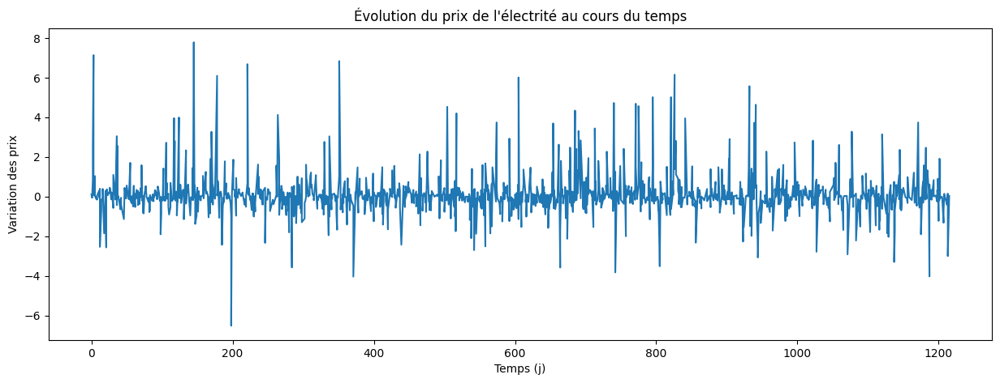

In [7]:
plt.figure(figsize=(15, 5))
plt.plot(df_sorted["DAY_ID"],df_sorted["TARGET"])
plt.title("Évolution du prix de l'électrité au cours du temps")
plt.xlabel("Temps (j)")
plt.ylabel("Variation des prix")

Text(0.5, 1.0, "Distribution de la variation des prix de l'électricité")

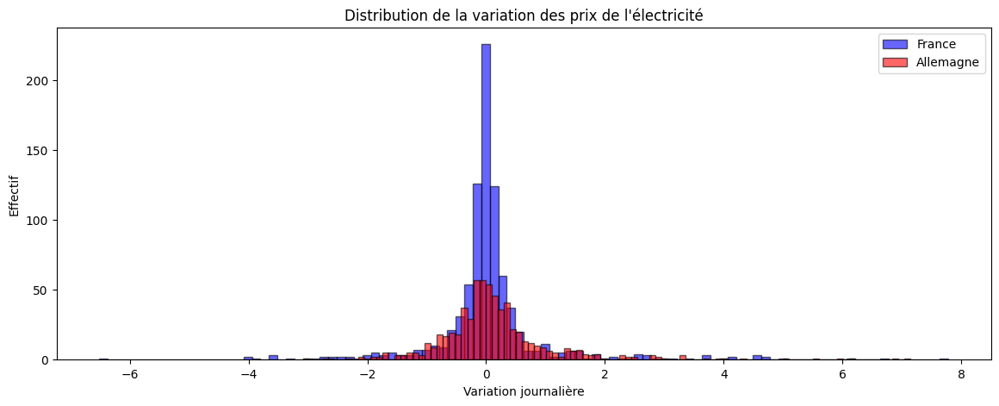

In [16]:
plt.figure(figsize=(14,5))
plt.hist(df_sorted[df_sorted["COUNTRY"] == "FR"]["TARGET"],bins=100, alpha=0.6, color='blue',edgecolor="black",label='France')
plt.hist(df_sorted[df_sorted["COUNTRY"] == "DE"]["TARGET"],bins=100, alpha=0.6, color='red',edgecolor="black",label='Allemagne')
plt.xlabel('Variation journalière')
plt.ylabel('Effectif')
plt.legend()
plt.title("Distribution de la variation des prix de l'électricité")

In [20]:
from scipy.stats import kurtosis

# Exemple : sur une série
kurt1 = kurtosis(df_sorted[df_sorted["COUNTRY"] == "DE"]["TARGET"].dropna())
kurt2 = kurtosis(df_sorted[df_sorted["COUNTRY"] == "FR"]["TARGET"].dropna())
print("Kurtosis excessive :", kurt1+3)
print("Kurtosis excessive :", kurt2+3)

Kurtosis excessive : 13.976491506340842
Kurtosis excessive : 17.199791502311495


## Analyse des matières premières

### Pour le gaz

On sait qu'en Europe, le prix de l'électricité est fixé selon le principe de "merit order". En effet, le prix est fixé selon le coût marginal de production des installations. Cela signifie que que les centrales dont les coûts marginaux sont les plus forts sont appelées en dernier. Le plus souvent, il s'agit des centrales à gaz. 

Text(0.5, 1.0, "Variation du prix de l'électricité en fonction du prix du gaz")

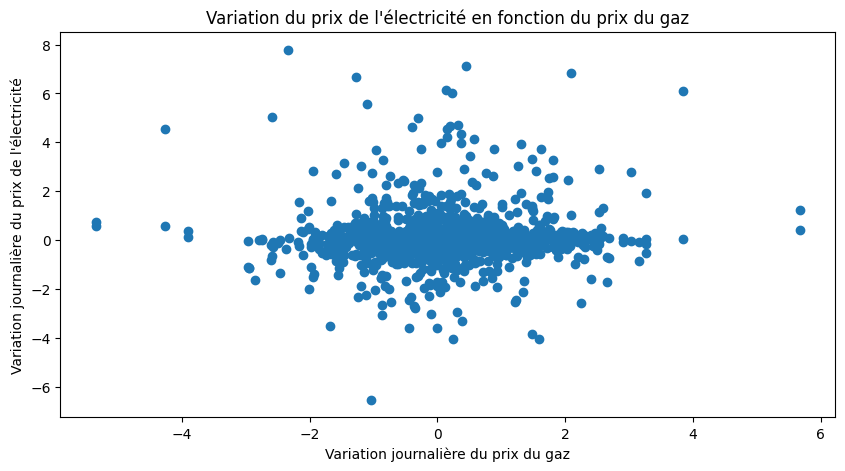

In [9]:
plt.figure(figsize=(10, 5))
plt.scatter(df_sorted["GAS_RET"], df_sorted["TARGET"])
plt.xlabel("Variation journalière du prix du gaz")
plt.ylabel("Variation journalière du prix de l'électricité")
plt.title("Variation du prix de l'électricité en fonction du prix du gaz")

Il n'y a pas de lien marqué. La plupart des valeurs sont centrées sur 0. Il est tentant de dire que la variation journalière du prix de l'électricité est indépendante de celle du gaz.

### Pour le charbon 

Text(0.5, 1.0, "Variation du prix de l'électricité en fonction de celles du charbon")

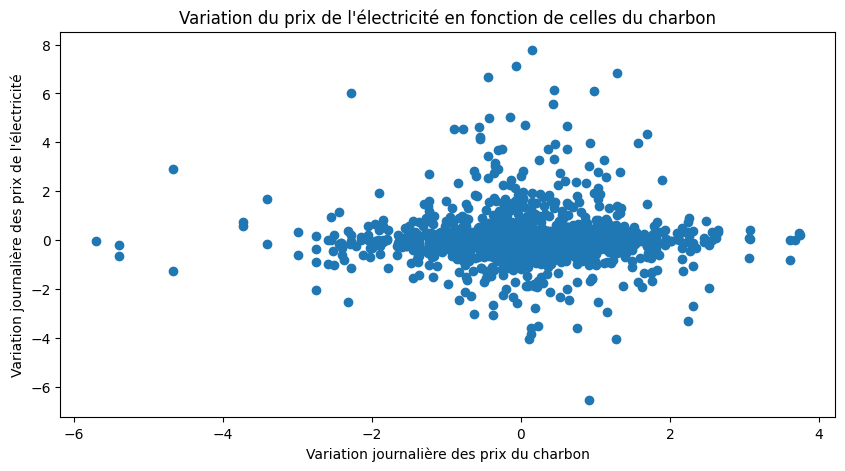

In [10]:
plt.figure(figsize=(10,5))
plt.scatter(df_sorted["COAL_RET"],df_sorted["TARGET"])
plt.xlabel("Variation journalière des prix du charbon")
plt.ylabel("Variation journalière des prix de l'électricité")
plt.title("Variation du prix de l'électricité en fonction de celles du charbon")

Même commentaire que pour le gaz...

### Futures sur les émissions de carbone

Text(0.5, 1.0, "Variations des prix de l'électricité en fonction des futures sur les émissions de carbone")

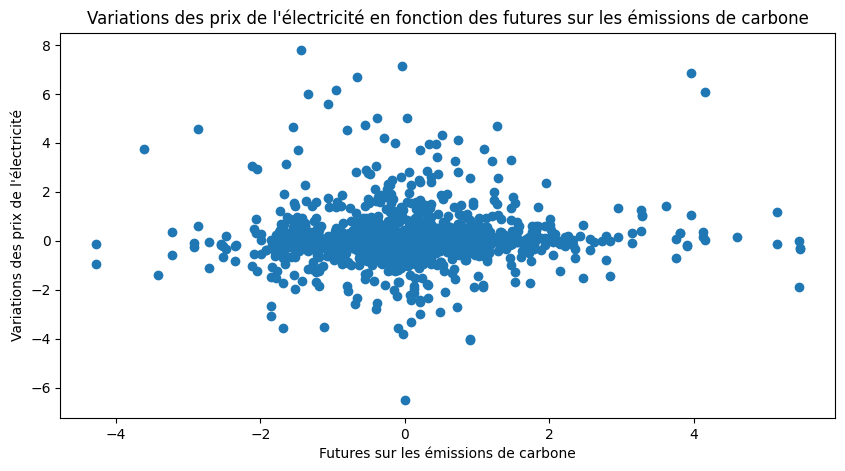

In [11]:
plt.figure(figsize=(10,5))
plt.scatter(df_sorted['CARBON_RET'],df_sorted['TARGET'])
plt.xlabel("Futures sur les émissions de carbone")
plt.ylabel("Variations des prix de l'électricité")
plt.title("Variations des prix de l'électricité en fonction des futures sur les émissions de carbone")

Idem.

C:\Users\qevan\AppData\Local\Temp\ipykernel_17696\2521516741.py:1: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot(


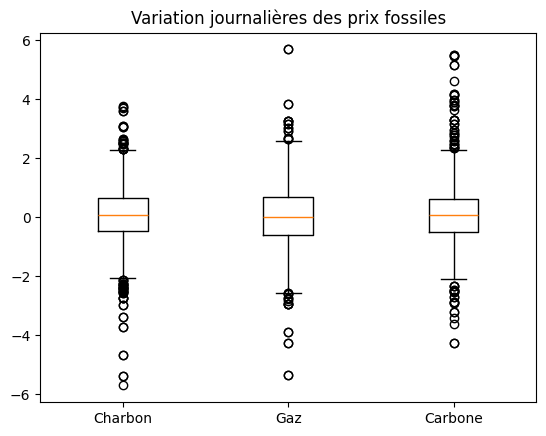

In [33]:
plt.boxplot(
    [df_sorted["COAL_RET"], df_sorted["GAS_RET"], df_sorted["CARBON_RET"]],
    labels=["Charbon", "Gaz", "Carbone"]
)
plt.title("Variation journalières des prix fossiles")
plt.show()

Le jeu de données étant standardisé, la moyenne se trouve à zéro pour les trois fossiles. Cependant, en observant le boxplot gaz, celui-ci présente un outlier qui surpasse tous les autres (gaz et carbone).

## Analyse de la météo

### Température 

Text(0.5, 1.0, "Variation de la consommation d'électricité en fonction de la température")

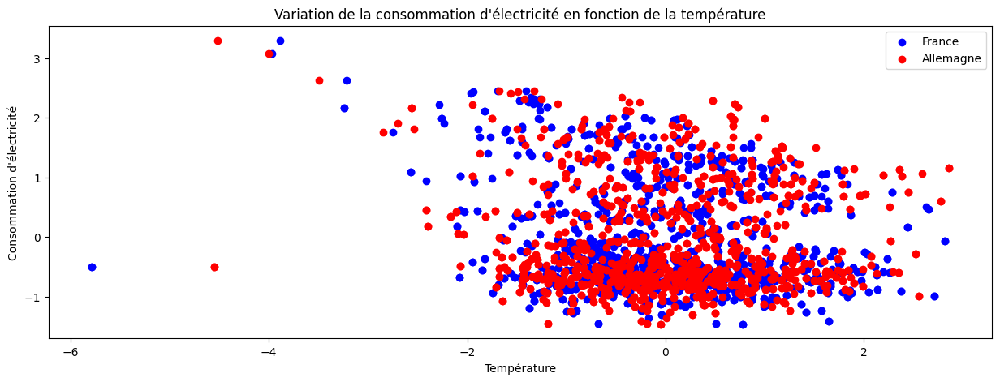

In [37]:
plt.figure(figsize=(15, 5))
plt.scatter(df_sorted['FR_TEMP'],df_sorted['FR_CONSUMPTION'], color='blue', label="France")
plt.scatter(df_sorted['DE_TEMP'],df_sorted['FR_CONSUMPTION'], color='red' ,label="Allemagne")
plt.legend()
plt.xlabel('Température')
plt.ylabel("Consommation d'électricité")
plt.title("Variation de la consommation d'électricité en fonction de la température")

De façon assez logique, la tendance est à la décroissance de la consommation d'électricité avec la température. Cela peut s'expliquer par des besoins réduits en chauffage notamment. La tendance est similaire entre l'Allemagne et la France.

### Pluviométrie

Text(0.5, 1.0, "Variation de la consommation d'électricité en fonction de la pluviométrie")

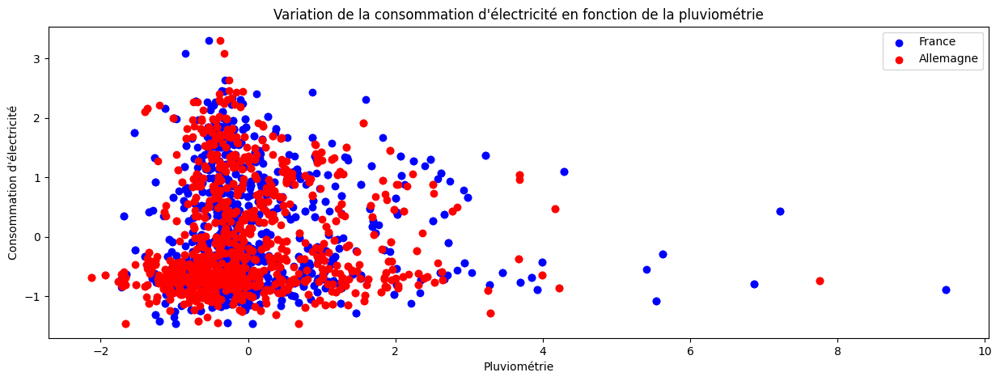

In [39]:
plt.figure(figsize=(15, 5))
plt.scatter(df_sorted['FR_RAIN'],df_sorted['FR_CONSUMPTION'], color='blue', label="France")
plt.scatter(df_sorted['DE_RAIN'],df_sorted['FR_CONSUMPTION'], color='red' ,label="Allemagne")
plt.legend()
plt.xlabel('Pluviométrie')
plt.ylabel("Consommation d'électricité")
plt.title("Variation de la consommation d'électricité en fonction de la pluviométrie")

Grosse variabilité de la consommation autour de 0.

### Impact de la météo sur la production de EnR.

Text(0.5, 1.0, 'Production éolienne en fonction du vent')

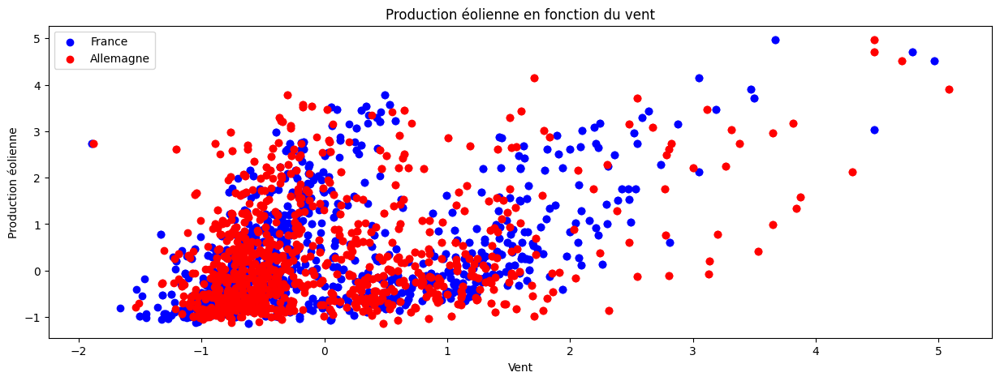

In [43]:
plt.figure(figsize=(15, 5))
plt.scatter(df_sorted['FR_WIND'],df_sorted['FR_WINDPOW'], color='blue', label="France")
plt.scatter(df_sorted['DE_WIND'],df_sorted['FR_WINDPOW'], color='red' ,label="Allemagne")
plt.legend()
plt.xlabel('Vent')
plt.ylabel("Production éolienne")
plt.title("Production éolienne en fonction du vent")

Tendance à la hausse de la production éolienne avec le vent de façon assez logique. Il y a tout de même deux points, simultanés pour lesquelles le vent était faible mais la production importante. 

Text(0.5, 1.0, 'Production hydraulique en fonction de la pluie')

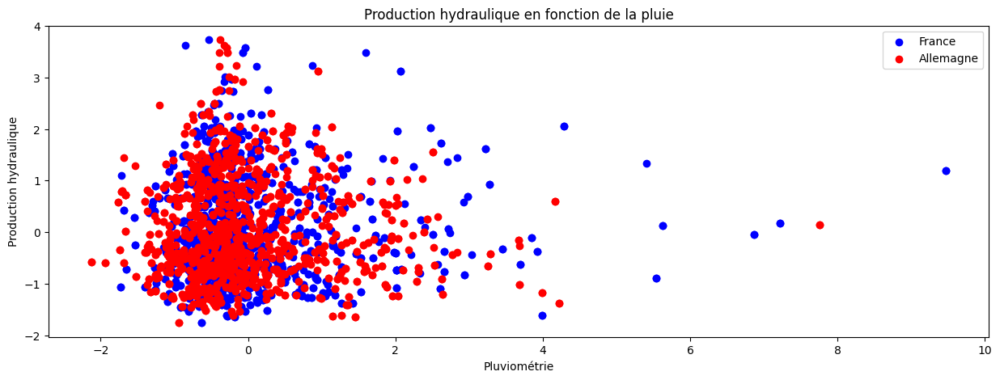

In [45]:
plt.figure(figsize=(15, 5))
plt.scatter(df_sorted['FR_RAIN'],df_sorted['FR_HYDRO'], color='blue', label="France")
plt.scatter(df_sorted['DE_RAIN'],df_sorted['FR_HYDRO'], color='red' ,label="Allemagne")
plt.legend()
plt.xlabel('Pluviométrie')
plt.ylabel("Production hydraulique")
plt.title("Production hydraulique en fonction de la pluie")

Il n'y a pas vraiement de lien visible entre la pluie et la production : ceci peut s'expliquer par le temps de réaction des bassins versants. L'infiltration dans les nappes, en fonction de la géologie des terrains peu être plus ou moins longue.

Text(0.5, 1.0, 'Production photovoltaïque en fonction de la pluviométrie')

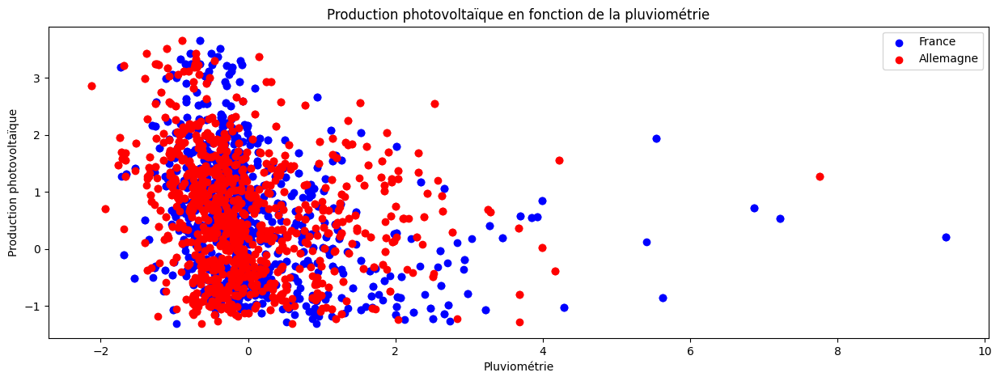

In [48]:
plt.figure(figsize=(15, 5))
plt.scatter(df_sorted['FR_RAIN'],df_sorted['FR_SOLAR'], color='blue', label="France")
plt.scatter(df_sorted['DE_RAIN'],df_sorted['FR_SOLAR'], color='red' ,label="Allemagne")
plt.legend()
plt.xlabel('Pluviométrie')
plt.ylabel("Production photovoltaïque")
plt.title("Production photovoltaïque en fonction de la pluviométrie")

Quand il pleut, il y a des nuages et donc moins de luminosité. Assez logiquement, la production photovoltaïque décroit. Le même phénomène se produit avec l'augmentation de la température mais le phénomène est bien plus faible. 

## Corrélation entre les variables 

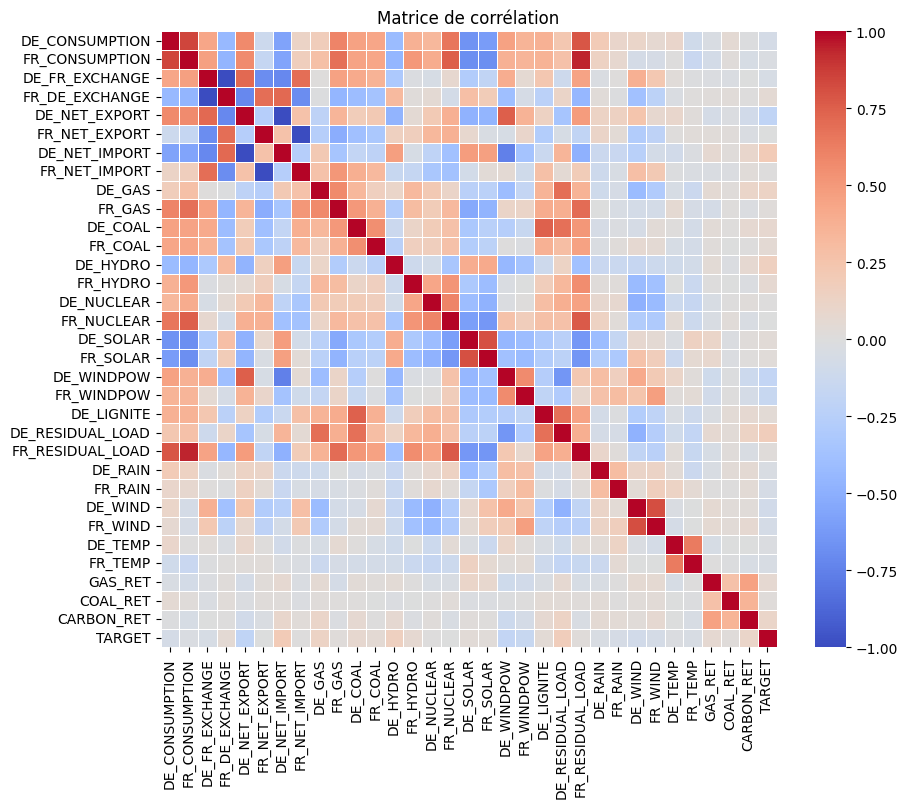

In [22]:

df_cor=df.drop(['ID','DAY_ID','COUNTRY'], axis=1, inplace=False)
matrix=df_cor.corr("spearman")
plt.figure(figsize=(10, 8))  
sns.heatmap(matrix, annot=False, cmap='coolwarm', fmt=".2f", linewidths=0.5, square=True)
plt.title("Matrice de corrélation")
plt.show()

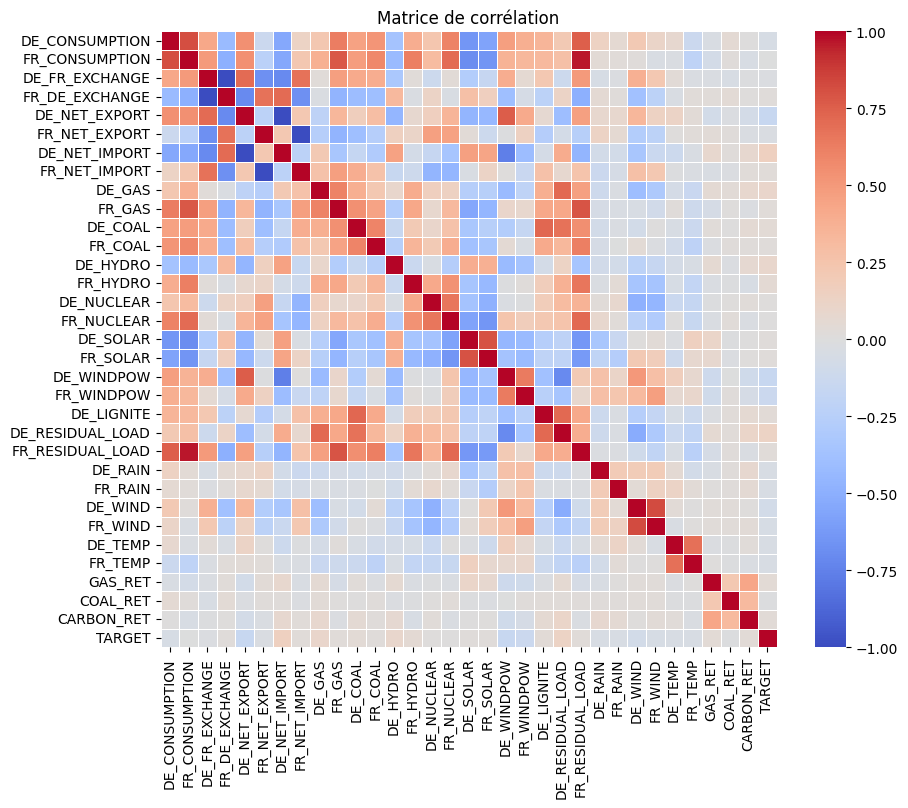

In [23]:
df_cor=df.drop(['ID','DAY_ID','COUNTRY'], axis=1, inplace=False)
matrix=df_cor.corr()
plt.figure(figsize=(10, 8))  
sns.heatmap(matrix, annot=False, cmap='coolwarm', fmt=".2f", linewidths=0.5, square=True)
plt.title("Matrice de corrélation")
plt.show()

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

import pandas as pd

# Fusionner X_train et y_train si y_train est une Series
df_corr = pd.concat([X_train, y_train.rename("TARGET")], axis=1)

# Calculer la matrice de corrélation de Spearman
spearman_matrix = df_corr.corr(method="spearman")

# Afficher la corrélation avec la cible
print(spearman_matrix["TARGET"].sort_values(ascending=False))

plt.figure(figsize=(12, 8))
sns.heatmap(spearman_matrix, annot=True, cmap="coolwarm", center=0)
plt.title("Matrice de corrélation de Spearman")
plt.tight_layout()
plt.show()


C:\Users\qevan\AppData\Local\Temp\ipykernel_17696\1532603255.py:1: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot(


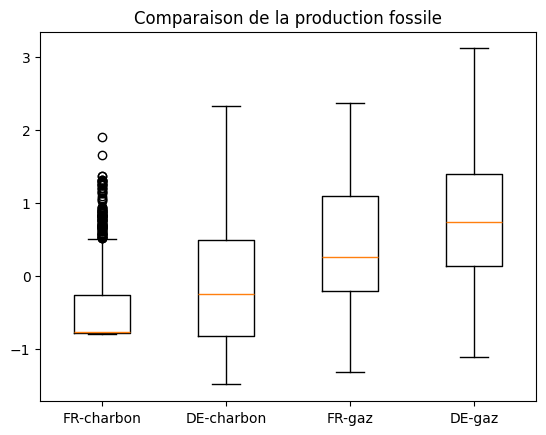

In [31]:
plt.boxplot(
    [df_sorted["FR_COAL"], df_sorted["DE_COAL"], df_sorted["FR_GAS"], df_sorted["DE_GAS"]],
    labels=["FR-charbon", "DE-charbon", "FR-gaz", "DE-gaz"]
)
plt.title("Comparaison de la production fossile")
plt.show()

C:\Users\qevan\AppData\Local\Temp\ipykernel_17696\3107116397.py:2: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot(


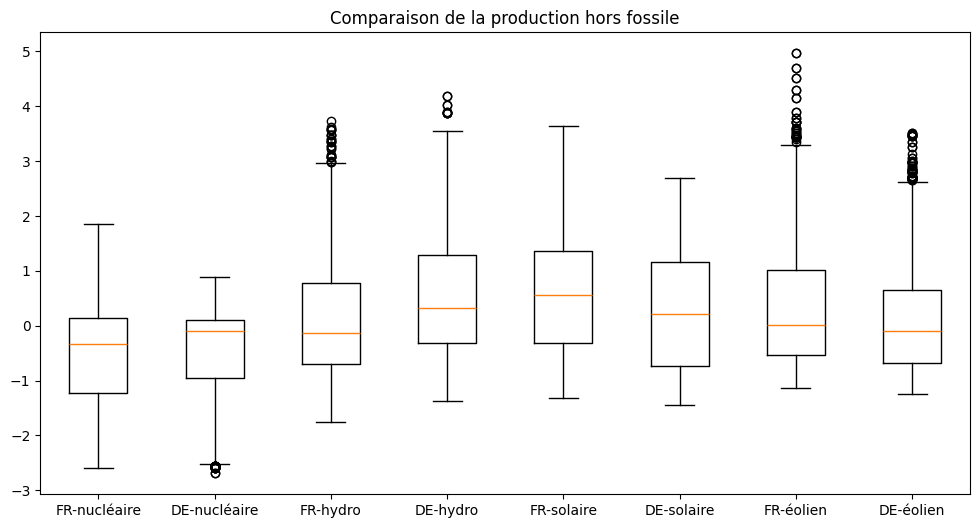

In [56]:
plt.figure(figsize=(12,6))
plt.boxplot(
    [df_sorted["FR_NUCLEAR"], df_sorted["DE_NUCLEAR"], df_sorted["FR_HYDRO"], df_sorted["DE_HYDRO"],df_sorted["FR_SOLAR"], df_sorted["DE_SOLAR"], df_sorted["FR_WINDPOW"],df_sorted["DE_WINDPOW"]],
    labels=["FR-nucléaire", "DE-nucléaire", "FR-hydro", "DE-hydro", "FR-solaire", "DE-solaire", "FR-éolien", "DE-éolien"]
)
plt.title("Comparaison de la production hors fossile")
plt.show()

In [9]:
# Sélection des colonnes numériques seulement
numeric_df = df_sorted.select_dtypes(include="number")

# Génération du pairplot
sns.pairplot(numeric_df)
plt.suptitle("Matrice de dispersion des variables numériques", y=1.02)
plt.show()